<a href="https://colab.research.google.com/github/ajaym416/Naamii/blob/master/smartphone_cysts.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.6.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# install detectron2: (colab has CUDA 10.1 + torch 1.6)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.6")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
     |████████████████████████████████| 6.6MB 4.6MB/s 
     |████████████████████████████████| 2.2MB 4.5MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.1.post20200716-cp36-none-any.whl size=42325 sha256=99479066248914c0607742921fe2a1d53621039527c7ee5e8c6b5e9374ac1ad3
  Stored in directory: /root/.cache/pip/wheels/81/99/f4/42a6bef61c07b3d78dfe6d7ebff259444c4526504cf72378d7
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# drive.flush_and_unmount

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import torch, torchvision

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode
import skimage.draw
import math


In [ ]:
# import os, json, cv2, random,math
# json_file = "/content/drive/My Drive/Smartphone/via_project_12Aug2020_17h14m.json"
# with open(json_file) as f:
#     imgs_annss = json.load(f)
# #This json file also contains the via_settings  / metadata and region attrib
# list_dict = []
# for i , v in enumerate(imgs_annss.values()):
#   print(v)
#   list_dict.append(v)
# imgs_anns=list_dict[1].values()

In [ ]:
def get_cysts_dicts(img_dir, split):
    json_file = "/content/drive/My Drive/Smartphone/via_project_12Aug2020_17h14m.json"
    with open(json_file) as f:
        imgs_annss = json.load(f)
    #This json file also contains the via_settings  / metadata and region attrib
    list_dict = []
    for i , v in enumerate(imgs_annss.values()):
      # print(v)
      list_dict.append(v)
    imgs_anns=list_dict[1]
    dataset_dicts = []

    # loop through the entries in the JSON file
    for idx, v in enumerate(imgs_anns.values()):
        record = {}
        # add file_name, image_id, height and width information to the records
        filename = os.path.join(img_dir, v["filename"])
        # print(idx,filename)
        if os.path.isfile(filename):
          pass
        else:
          print("Image not found" ,filename )
          continue
        height, width = cv2.imread(filename).shape[:2]
        # print(height ,width)
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]

        objs = []
        # one image can have multiple annotations, therefore this loop is needed
        for annotation in annos:
            # reformat the polygon information to fit the specifications
            anno = annotation["shape_attributes"]
            #Since we  only have the ellipse
            # if anno["name"]== "ellipse"
            # "cx":171,"cy":227,"rx":7.6,"ry":8.158,"theta":0.197
            cx = anno["cx"]
            cy = anno["cy"]
            rx= anno["rx"]
            ry=anno["ry"]
            theta =anno["theta"]
            # px, py = skimage.draw.ellipse(cy, cx, ry, rx,rotation=theta)
            # # px, py = skimage.draw.ellipse_perimeter(cy,cx,round(ry),round(rx),orientation=theta)
            # poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            # poly = [p for x in poly for p in x]

            region_attributes = annotation["region_attributes"]["cyst"]

            # specify the category_id to match with the class.

            if "Giardia" in region_attributes:
                category_id = 1
            elif "Crypto" in region_attributes:
                category_id = 0
            def ellipse_to_rectange(rx,ry,theta):
              angle = theta*math.pi/180
              ea = rx*math.cos(theta)
              eb = ry*math.sin(theta)
              ec = rx*math.sin(theta)
              ed = ry*math.cos(theta)
              width = math.sqrt(math.pow(ea,2)+math.pow(eb,2))*2
              height = math.sqrt(math.pow(ec,2)+math.pow(ed,2))*2
              return (width ,height)
            width , height = ellipse_to_rectange(rx,ry,theta)

            obj = {
                # "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                # "bbox": [cx-rx+0.5, cy-ry+0.5, cx+rx+0.5 , cy+ry+0.5],
                "bbox": [cx-width*0.5,cy-height*0.5,cx+width*0.5,cy+height*0.5],
                "bbox_mode": BoxMode.XYXY_ABS,
                # "segmentation": [poly],
                "segmentation": [],
                "category_id": category_id,
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
        total_file = len(dataset_dicts)
        train_ratio , val_ratio , test_ratio = 0.8,0.1,0.1
        dataset_dicts_train = dataset_dicts[0:int(train_ratio*total_file)]
        dataset_dicts_val = dataset_dicts[int(train_ratio*total_file):int(train_ratio*total_file+val_ratio*total_file)]
        dataset_dicts_test = dataset_dicts[-int(test_ratio*total_file):]
    if split == "train":
      return dataset_dicts_train
    elif split == "test":
      return dataset_dicts_test
    elif split == "val":
      return dataset_dicts_val


In [ ]:
img_dir ="/content/drive/My Drive/Smartphone/Images"

In [ ]:
for d in ["train", "val","test"]:
    DatasetCatalog.register("cysts_" + d, lambda d=d: get_cysts_dicts("/content/drive/My Drive/Smartphone/Images/" , d))
    MetadataCatalog.get("cysts_" + d).set(thing_classes=["crypto" ,"Giardia"])
cysts_metadata = MetadataCatalog.get("cysts_train")

Image not found /content/drive/My Drive/Smartphone/Images/(564).jpg
/content/drive/My Drive/Smartphone/Images/(785).jpg


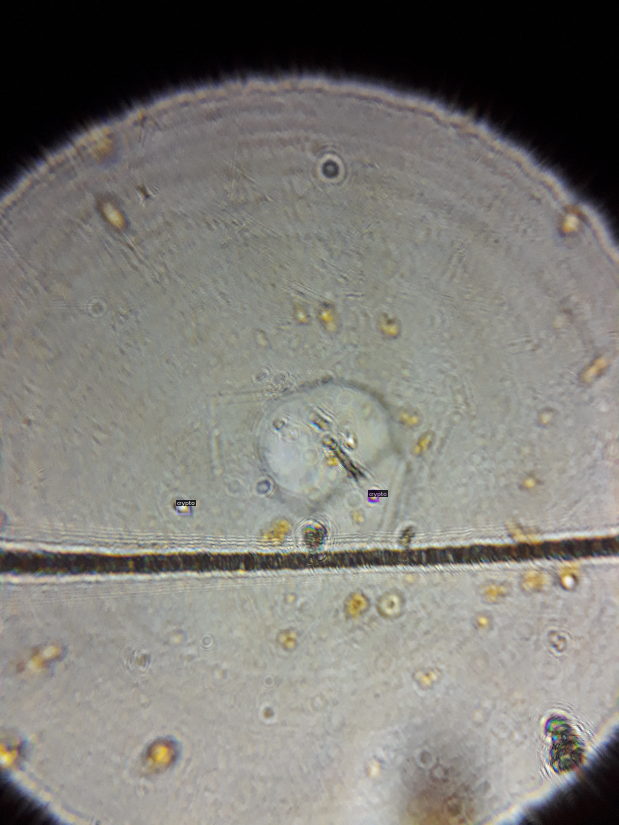

/content/drive/My Drive/Smartphone/Images/(736).jpg


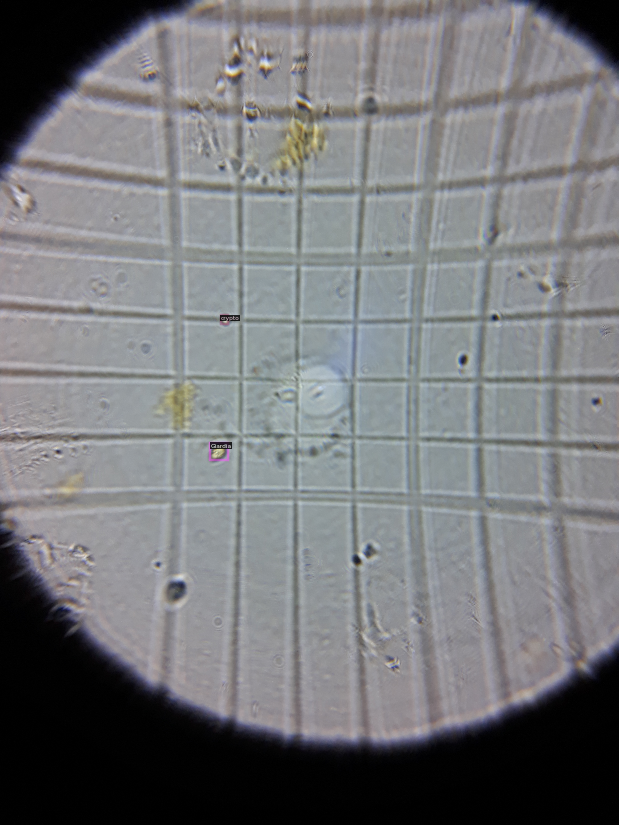

/content/drive/My Drive/Smartphone/Images/(740).jpg


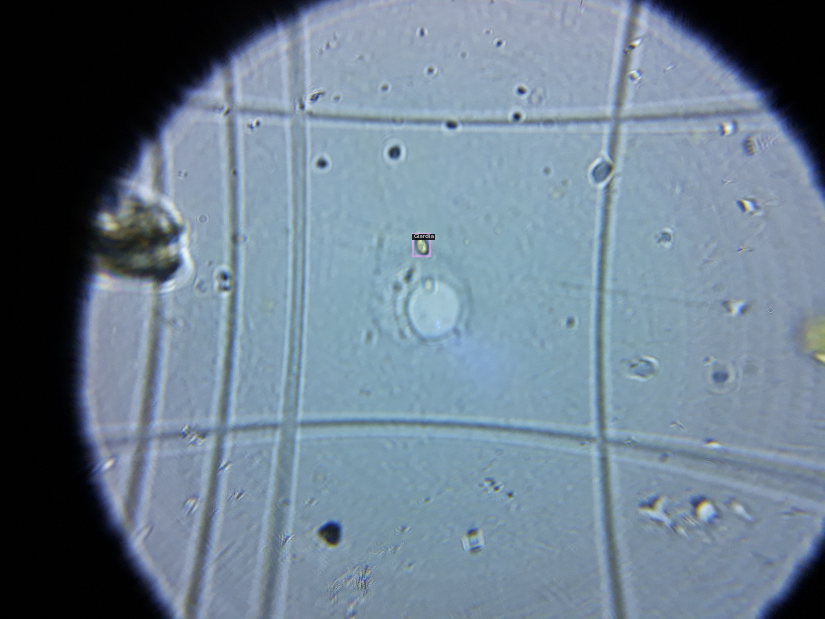

/content/drive/My Drive/Smartphone/Images/(795).jpg


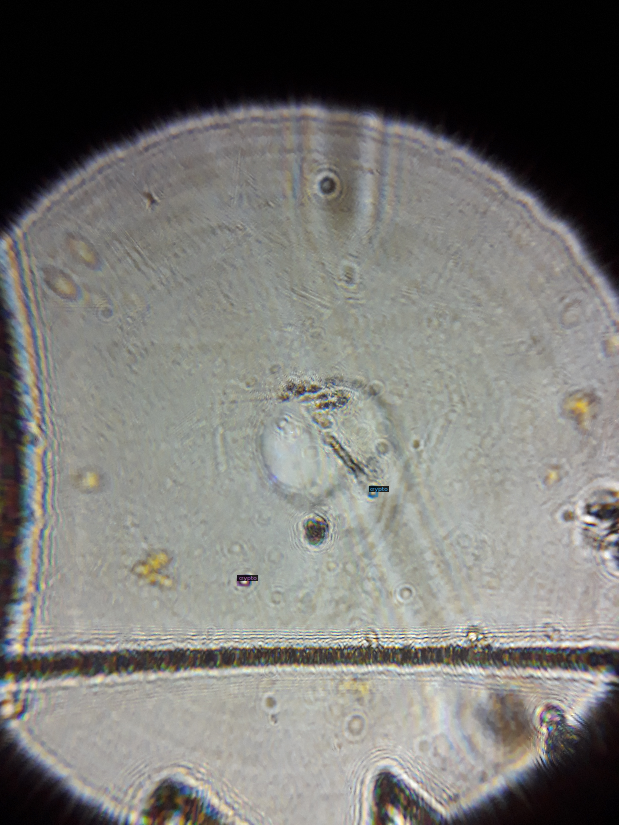

/content/drive/My Drive/Smartphone/Images/(806).jpg


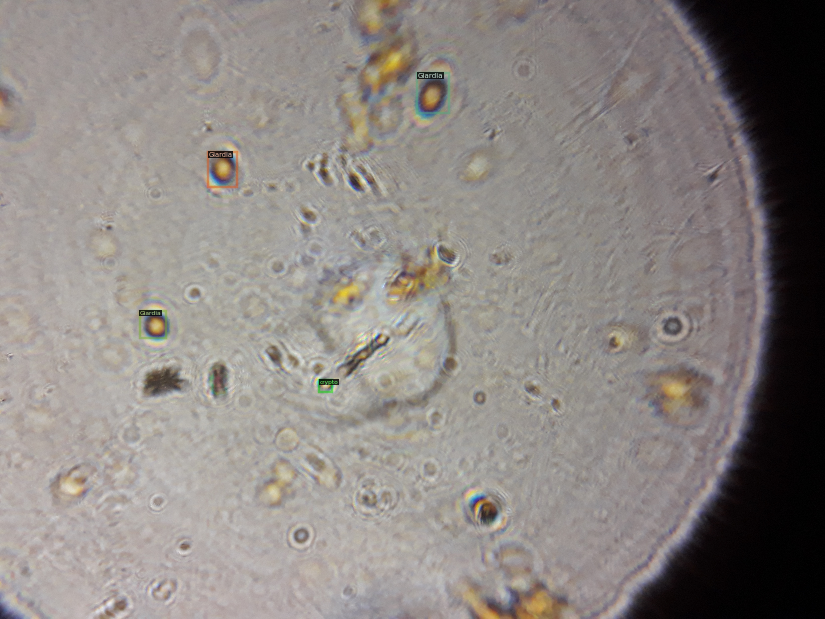

/content/drive/My Drive/Smartphone/Images/(771).jpg


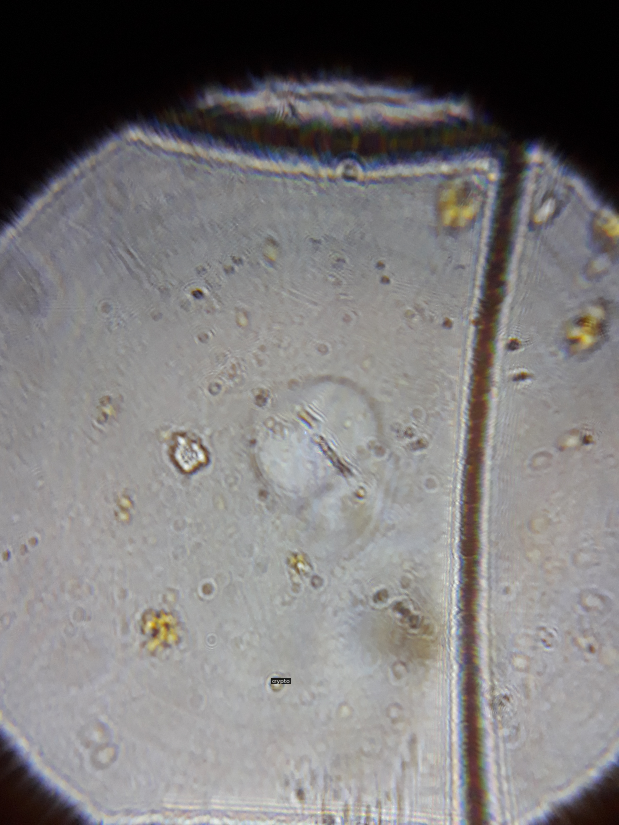

/content/drive/My Drive/Smartphone/Images/(754).jpg


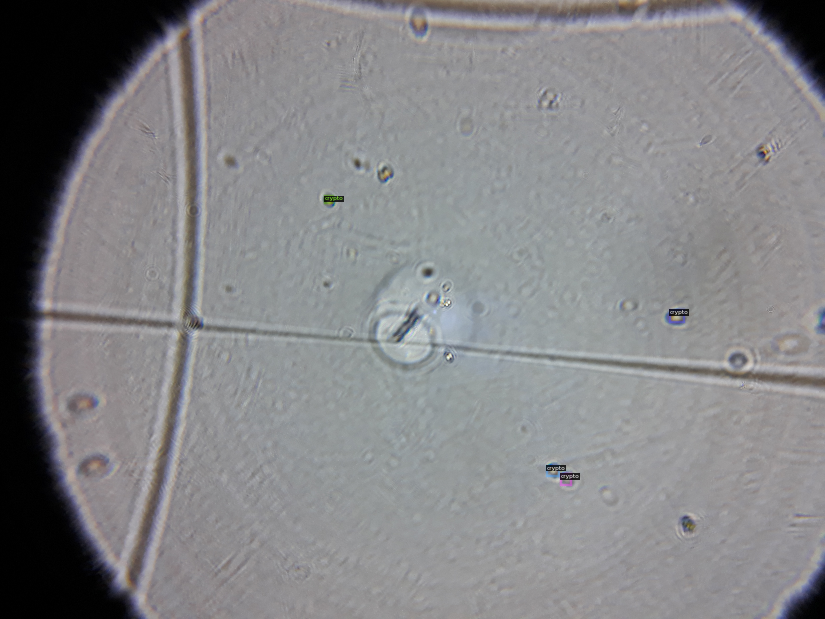

/content/drive/My Drive/Smartphone/Images/(758).jpg


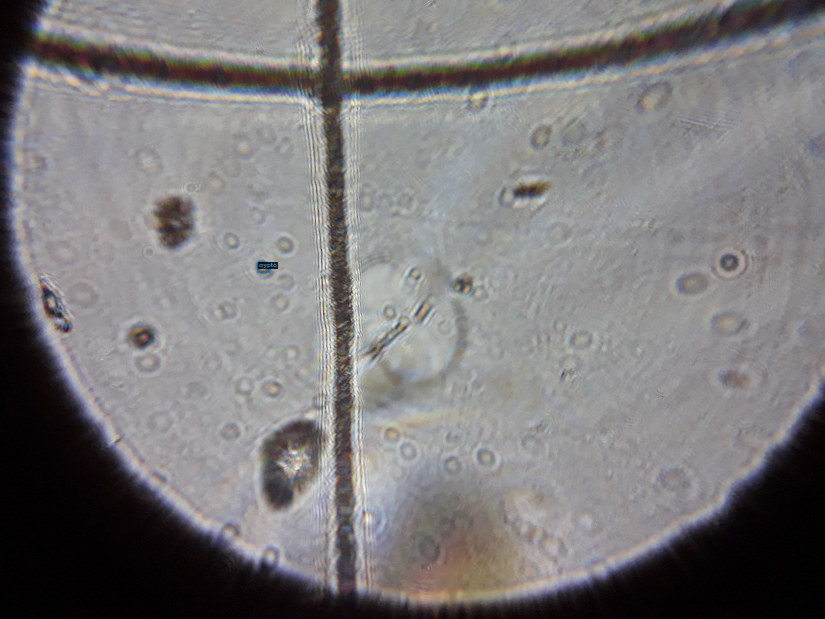

/content/drive/My Drive/Smartphone/Images/(775).jpg


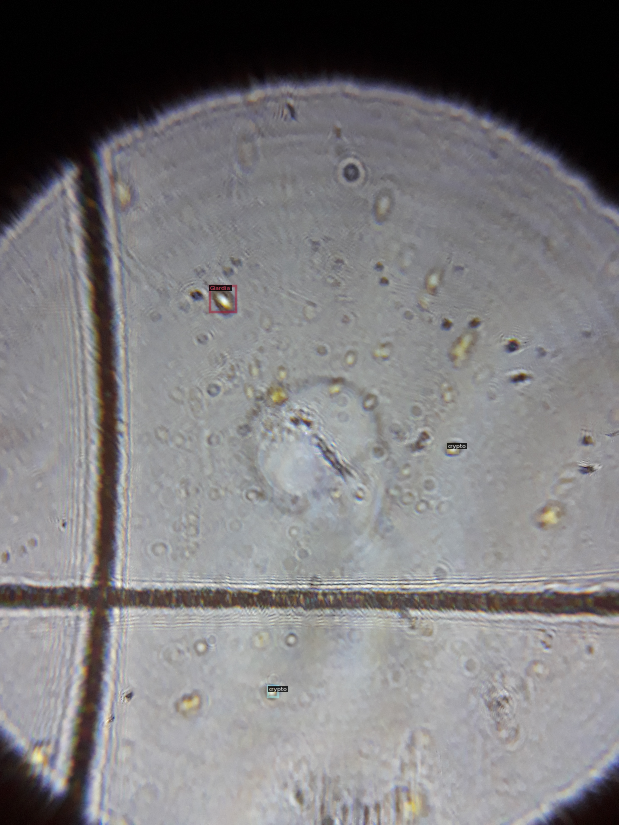

/content/drive/My Drive/Smartphone/Images/(814).jpg


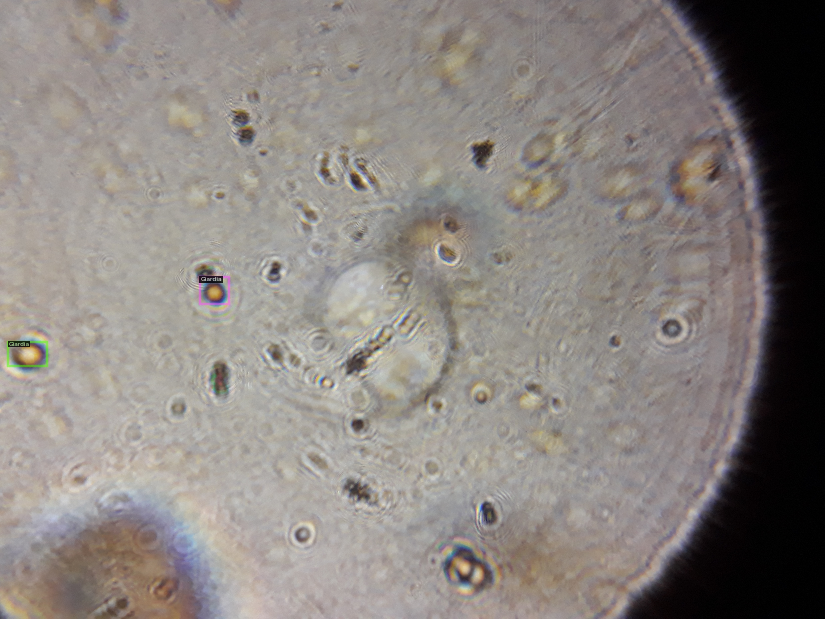

In [ ]:
dataset_dicts = get_cysts_dicts(img_dir ,"val")
for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    print(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=cysts_metadata, scale=0.2)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# json_file = "/content/drive/My Drive/Smartphone/via_project_12Aug2020_17h14m.json"
# with open(json_file) as f:
#     imgs_annss = json.load(f)
# #This json file also contains the via_settings  / metadata and region attrib
# list_dict = []
# for i , v in enumerate(imgs_annss.values()):
#   # print(v)
#   list_dict.append(v)
# imgs_anns=list_dict[1]
# type(imgs_anns.values())

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("cysts_train",)
cfg.DATASETS.TEST = ("cysts_val",)

cfg.DATALOADER.NUM_WORKERS = 4
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo

cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 200
cfg.SOLVER.MAX_ITER = 500 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (500, 1000)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 200


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[08/18 06:45:59 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:04, 94.6MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.


[08/18 06:49:03 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/layers/wrappers.py:226: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  return x.nonzero().unbind(1)


[08/18 06:50:06 d2.utils.events]:  eta: 0:22:37  iter: 19  total_loss: 1.994  loss_cls: 1.198  loss_box_reg: 0.252  loss_rpn_cls: 0.432  loss_rpn_loc: 0.044  time: 2.8509  data_time: 0.4081  lr: 0.000096  max_mem: 9390M
[08/18 06:51:07 d2.utils.events]:  eta: 0:21:25  iter: 39  total_loss: 1.069  loss_cls: 0.481  loss_box_reg: 0.483  loss_rpn_cls: 0.013  loss_rpn_loc: 0.025  time: 2.9411  data_time: 0.1674  lr: 0.000196  max_mem: 9390M
[08/18 06:52:07 d2.utils.events]:  eta: 0:21:20  iter: 59  total_loss: 1.060  loss_cls: 0.350  loss_box_reg: 0.644  loss_rpn_cls: 0.015  loss_rpn_loc: 0.019  time: 2.9601  data_time: 0.1918  lr: 0.000296  max_mem: 9390M
[08/18 06:53:07 d2.utils.events]:  eta: 0:20:49  iter: 79  total_loss: 0.916  loss_cls: 0.290  loss_box_reg: 0.579  loss_rpn_cls: 0.010  loss_rpn_loc: 0.021  time: 2.9779  data_time: 0.1828  lr: 0.000396  max_mem: 9390M
[08/18 06:54:09 d2.utils.events]:  eta: 0:19:59  iter: 99  total_loss: 0.775  loss_cls: 0.218  loss_box_reg: 0.516  loss

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
# %tensorboard --logdir output
%tensorboard --logdir "/content/output"

<IPython.core.display.Javascript object>

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/drive/My Drive/checkpoint.pth")
# cfg.MODEL.WEIGHTS ="/content/drive/My Drive/models/checkpoint.pth"

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.94
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("cysts_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "cysts_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[08/18 07:38:41 d2.evaluation.coco_evaluation]: 'cysts_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[08/18 07:38:41 d2.data.datasets.coco]: Converting annotations of dataset 'cysts_test' to COCO format ...)
Image not found /content/drive/My Drive/Smartphone/Images/(564).jpg
[08/18 07:41:38 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[08/18 07:41:38 d2.data.datasets.coco]: Conversion finished, #images: 83, #annotations: 233
[08/18 07:41:38 d2.data.datasets.coco]: Caching COCO format annotations at './output/cysts_test_coco_format.json' ...
Image not found /content/drive/My Drive/Smartphone/Images/(564).jpg
[08/18 07:44:35 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   crypto   | 35           |  Giardia   | 198          |
|            |              |            |        

OrderedDict([('bbox',
              {'AP': 26.0023323596479,
               'AP-Giardia': 41.80421947985635,
               'AP-crypto': 10.200445239439453,
               'AP50': 57.38789467143432,
               'AP75': 16.274310170489688,
               'APl': nan,
               'APm': nan,
               'APs': 48.50659747919534})])

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.WEIGHTS = "/content/drive/My Drive/colab_output/cysts_output/model_final.pth"
cfg.DATASETS.TEST = ("cysts_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.96   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("cysts_test")

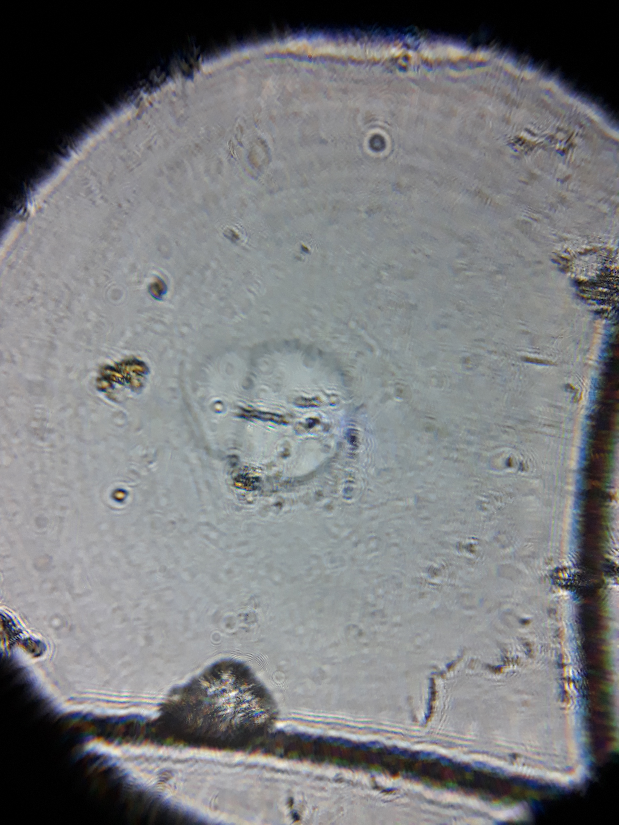

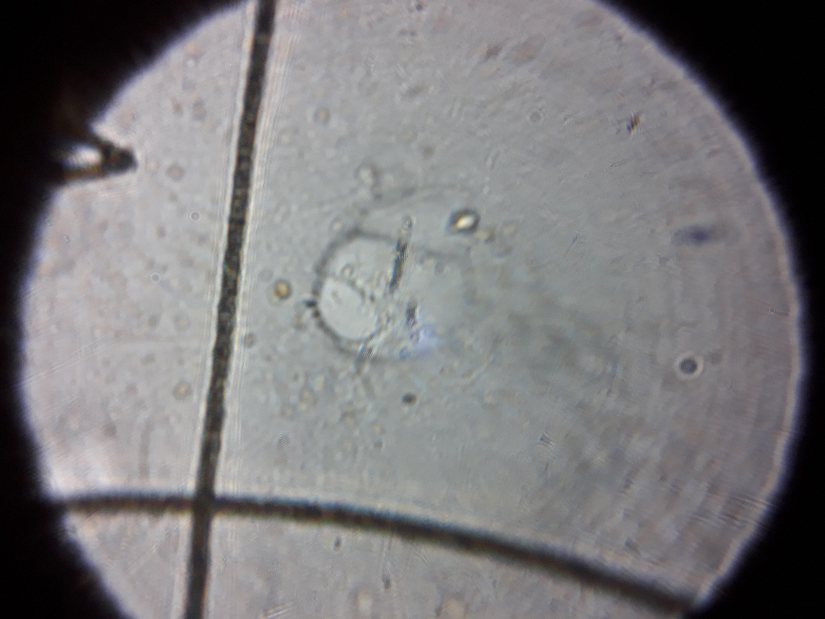

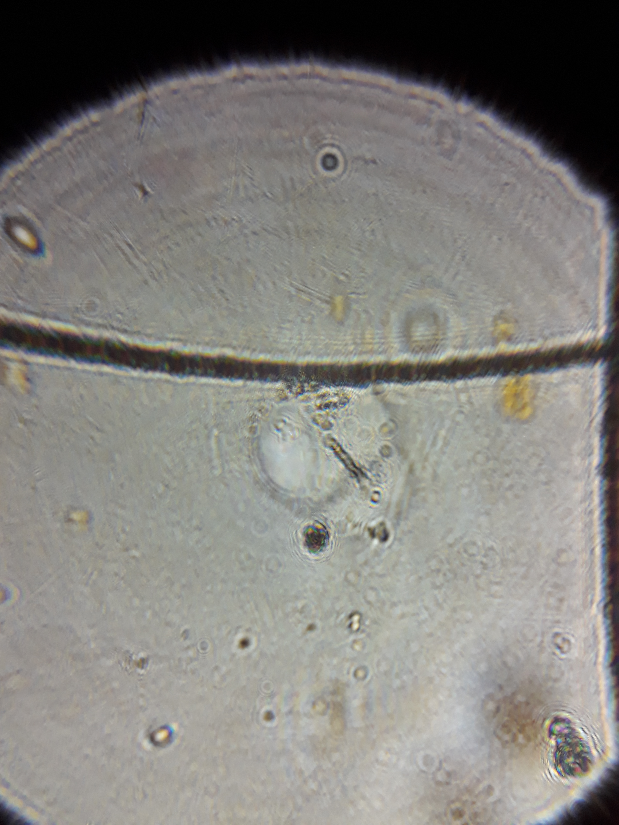

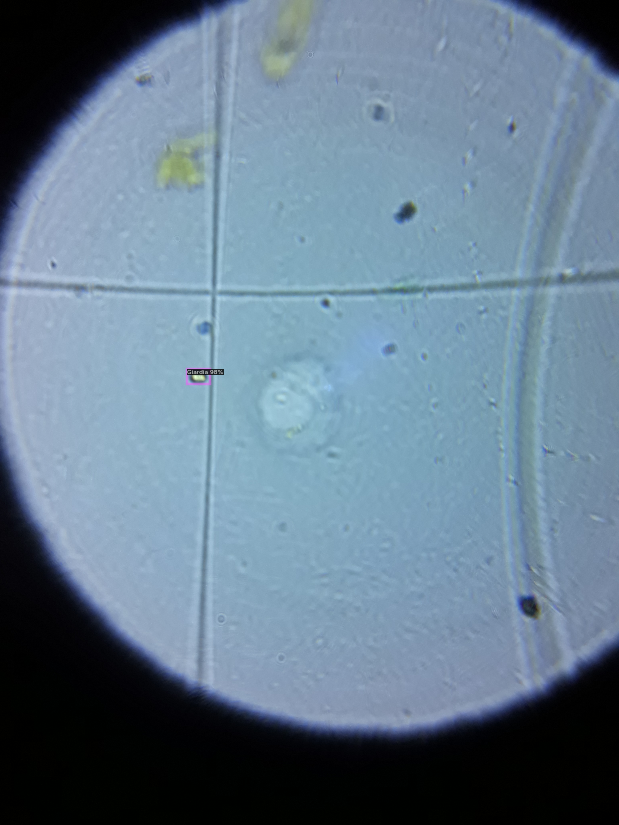

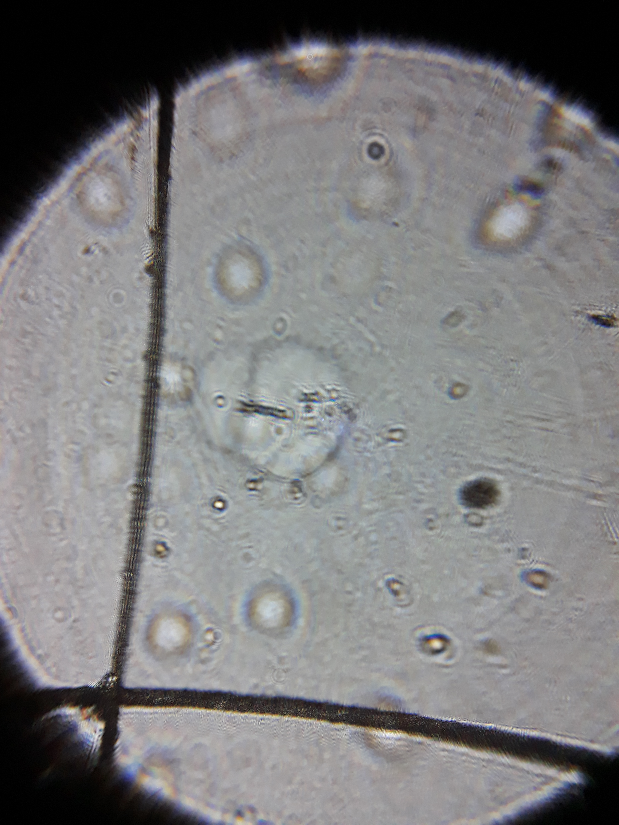

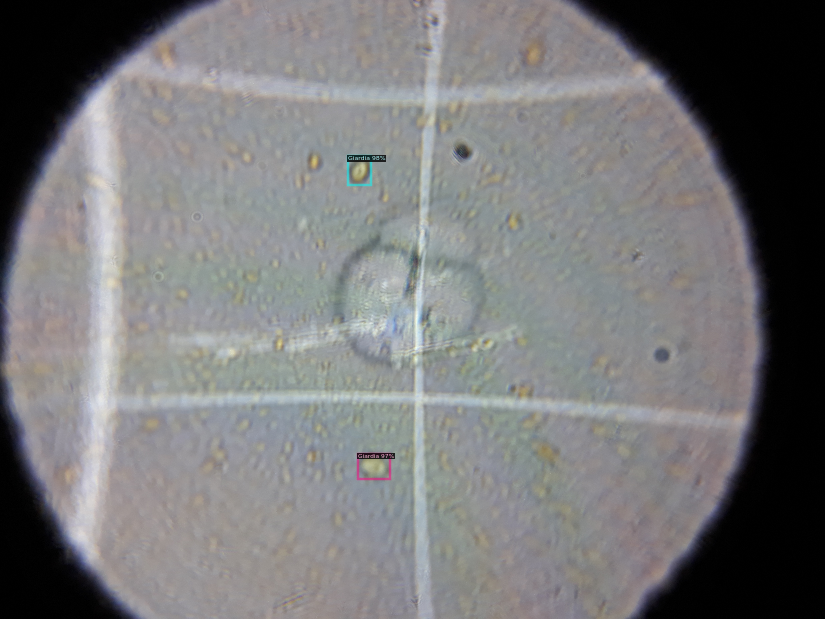

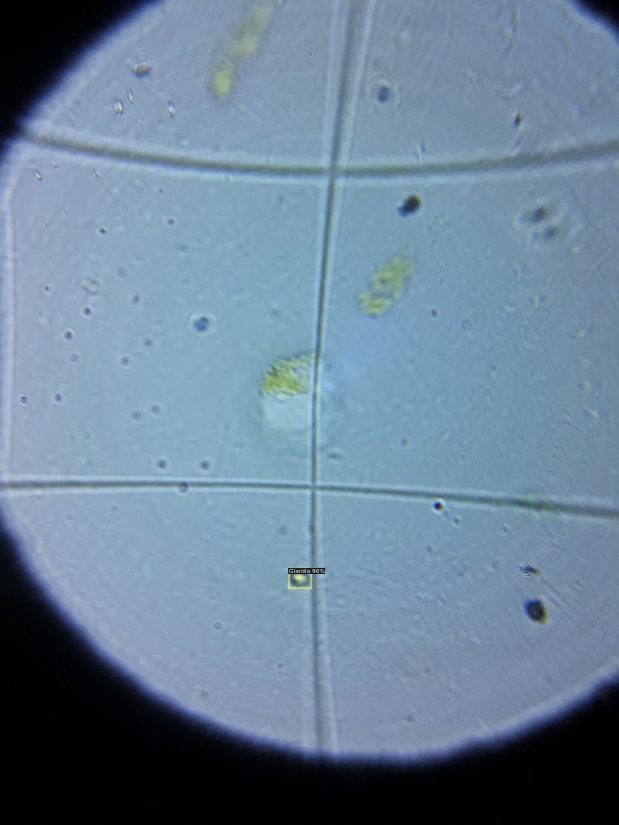

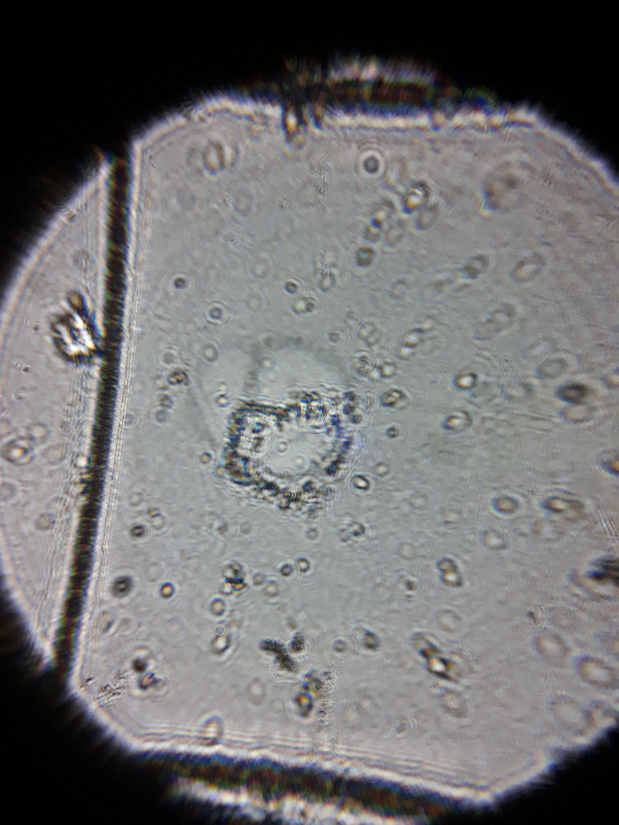

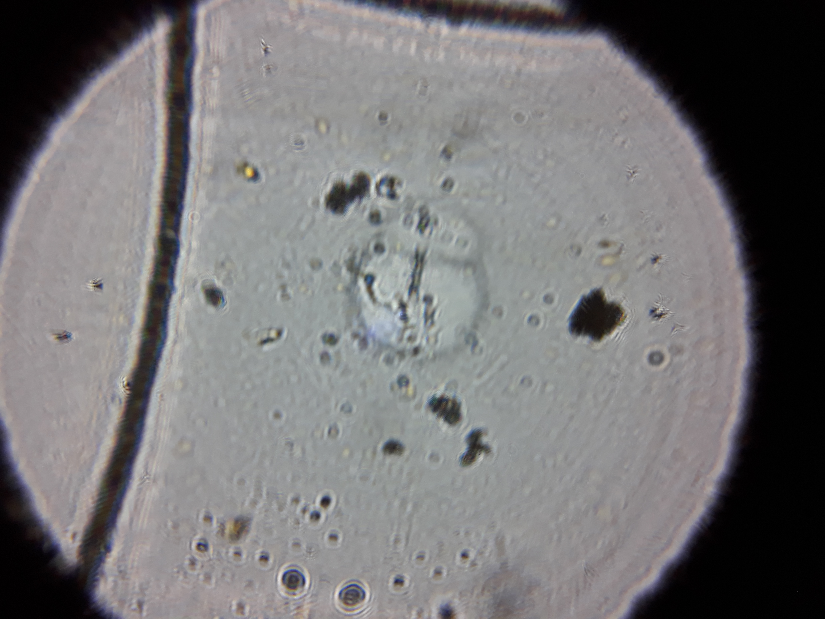

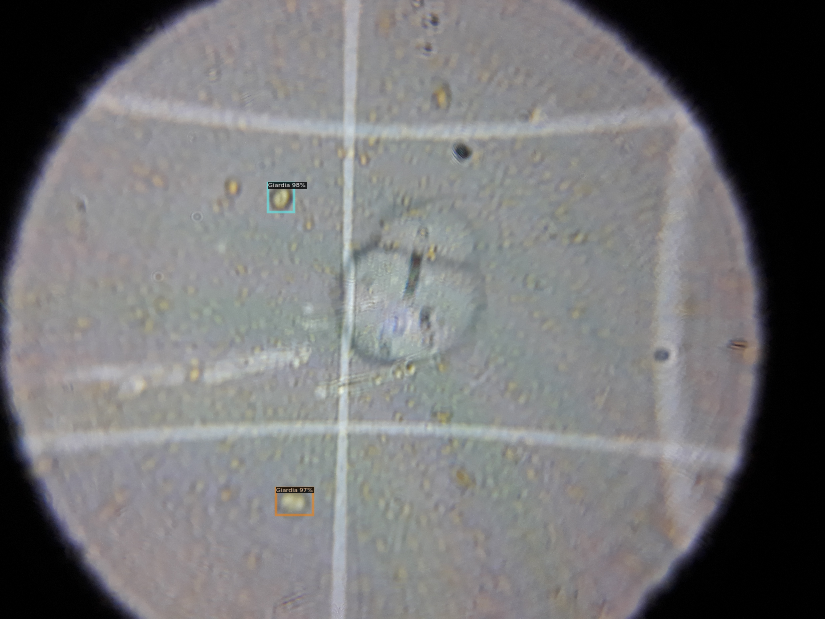

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in random.sample(glob.glob('/content/drive/My Drive/Smartphone/Images/*jpg'),10):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.2
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])